In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
import os
import torch as t
from utils.config import opt
from model import FasterRCNNVGG16
from trainer import FasterRCNNTrainer
from data.util import  read_image
from utils.vis_tool import vis_bbox
from utils import array_tool as at
import numpy as np
import pickle
from tqdm.auto import tqdm
from utils.config import opt
from data.dataset import Dataset, TestDataset
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt


TRAIN_MODE = False

import warnings
warnings.filterwarnings(action='once')

In [2]:
faster_rcnn = FasterRCNNVGG16()
trainer = FasterRCNNTrainer(faster_rcnn).cuda()

Setting up a new session...
/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/visdom/__init__.py:727: PendingDeprecationWarning: Visdom is eventually changing to default to raising exceptions rather than ignoring/printing. This change is expected to happen by July 2018. Please set `raise_exceptions` to False to retain current behavior.
  PendingDeprecationWarning
Traceback (most recent call last):
  File "/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/urllib3/connection.py", line 157, in _new_conn
    (self._dns_host, self.port), self.timeout, **extra_kw
  File "/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/urllib3/util/connection.py", line 84, in create_connection
    raise err
  File "/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/urllib3/util/connection.py", line 74, in create_connection
    sock.connect(sa)
ConnectionRefusedError: [Errno 111] Connection refused

During handling of the above exception, another exception occurred:

Exception in user code:
------------------------------------------------------------


# Load model trained with caffe pretrained model

In [3]:
%ls ./checkpoints/cars

baseline_results.pickle*                 kitti_features.pickle*
fasterrcnn_04151829_0.6704369972064141*  mahal_cov.pickle*
fasterrcnn_04151851_0.6877679369254311*  mahal_means.pickle*
fasterrcnn_04151914_0.7164561623943497*  mahal_result.pickle*
fasterrcnn_04151958_0.7435728692746989*  pred_bboxes_test.pickle*
fasterrcnn_04152043_0.7459420675485349*  pred_bboxes_test_softmax.pickle*
fasterrcnn_04152235_0.7462277363985176*  pred_labels_test.pickle*
gt_bboxes_test.pickle*                   pred_labels_test_softmax.pickle*
gt_difficults_test.pickle*               pred_scores_test.pickle*
gt_labels.pickle*                        pred_scores_test_softmax.pickle*
gt_labels_test.pickle*                   tsne_features.pickle*
inv_mahal_cov.pickle*


In [4]:
save_dir = './checkpoints/cars'

trainer.load(os.path.join(save_dir, 'fasterrcnn_04152235_0.7462277363985176'))

/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/torch/serialization.py:99: ResourceWarning: unclosed <socket.socket fd=81, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('0.0.0.0', 34578)>
  return storage_type(obj.size())


FasterRCNNTrainer(
  (faster_rcnn): FasterRCNNVGG16(
    (extractor): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): Re

# Display IDD images

In [5]:
dataset_dir = '/media/tadenoud/DATADisk/datasets/idd_detection/IDD_Detection/JPEGImages/'

img_paths = [
    os.path.join(dataset_dir, 'frontNear/BLR-2018-03-22_17-39-26_2_frontNear/000012_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-03-22_17-39-26_2_frontNear/000246_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-05-14_13-59-12_frontNear/000150_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-05-22_11-54-07_frontNear/000505_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-04-26_13-00-01_frontNear/0000780.jpg'),
    os.path.join(dataset_dir, 'rearNear/BLR-2018-05-07_12-01-06_rearNear/000600_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-04-16_15-24-27_frontNear/000054_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-04-16_15-24-27_frontNear/000186_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-04-16_15-24-27_frontNear/000192_r.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-04-16_15-34-27_frontNear/0000120.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-04-16_15-34-27_frontNear/0000180.jpg'),
    os.path.join(dataset_dir, 'frontNear/BLR-2018-04-16_15-34-27_frontNear/0000240.jpg'),
]

imgs = np.array([read_image(p) for p in img_paths])

/opt/conda/conda-bld/pytorch_1565272271120/work/torch/csrc/autograd/python_function.cpp:638: UserWarning: Legacy autograd function with non-static forward method is deprecated and will be removed in 1.3. Please use new-style autograd function with static forward method. (Example: https://pytorch.org/docs/stable/autograd.html#torch.autograd.Function)


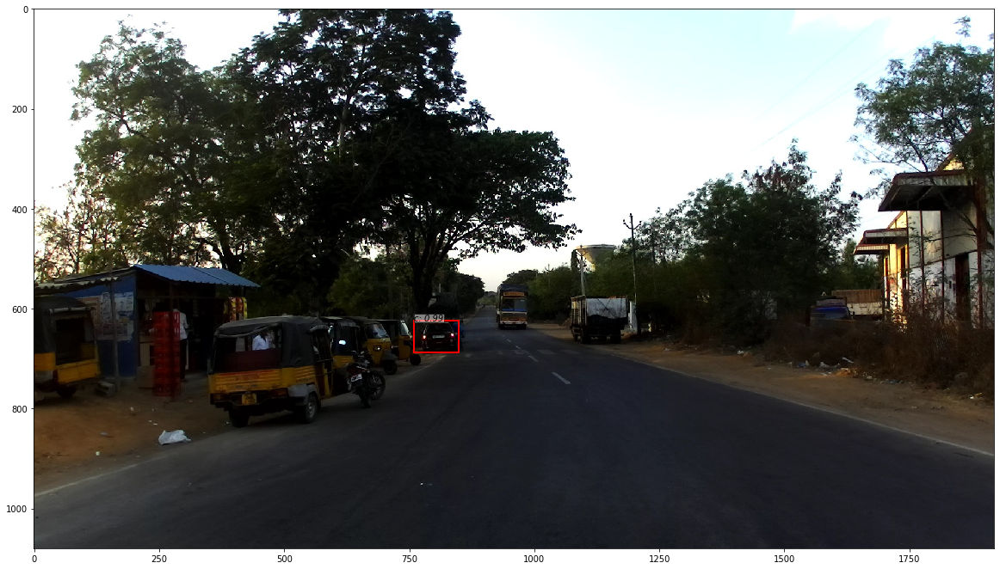

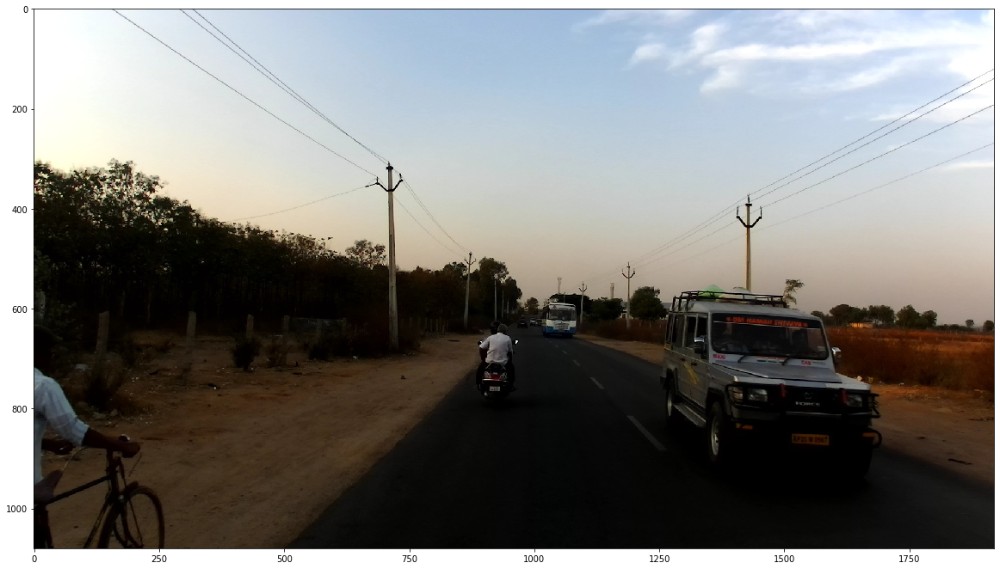

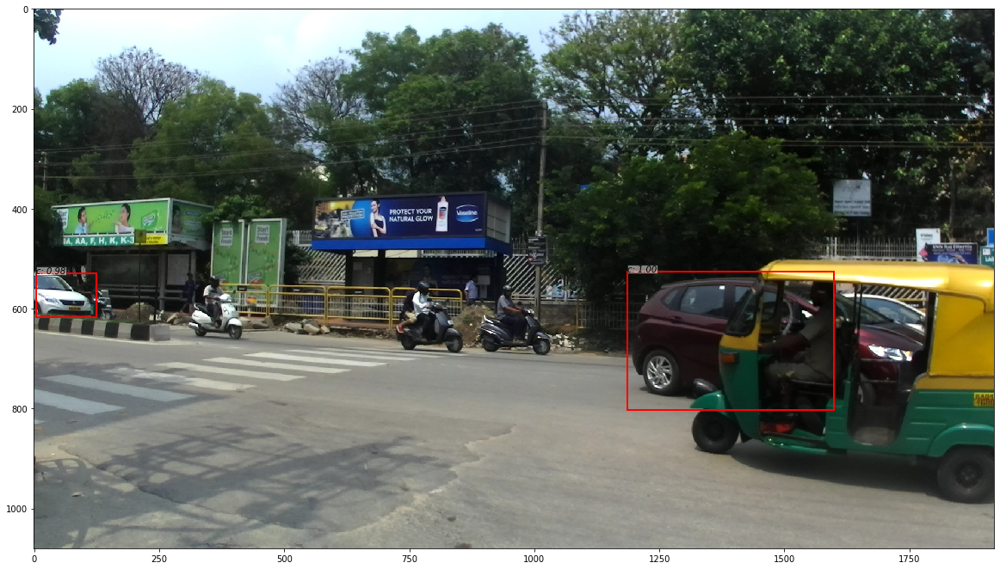

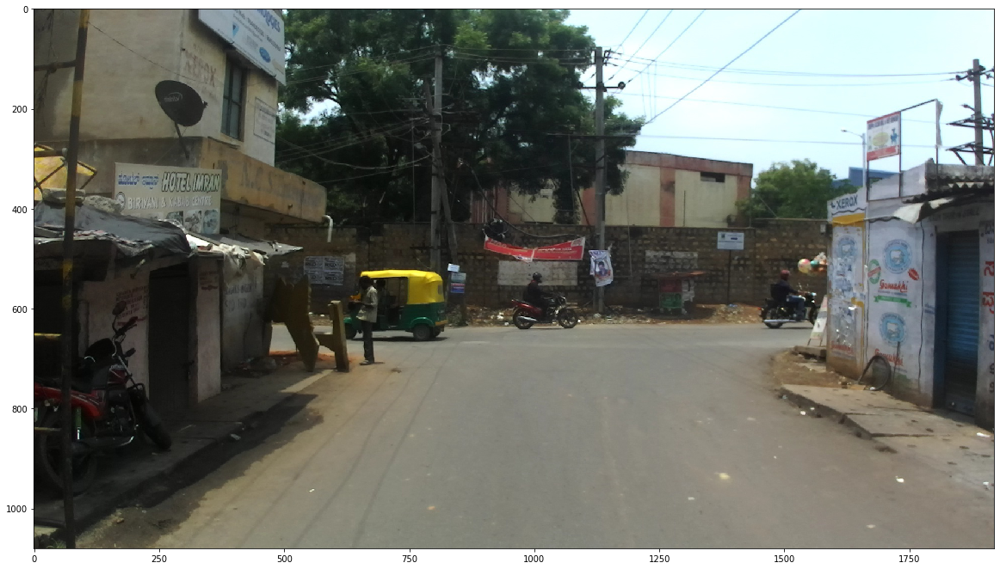

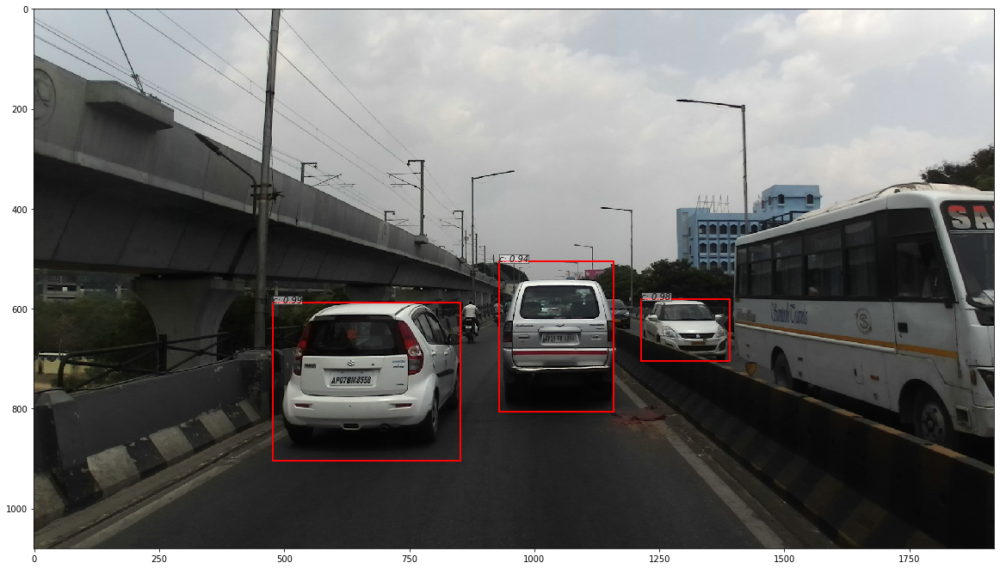

...

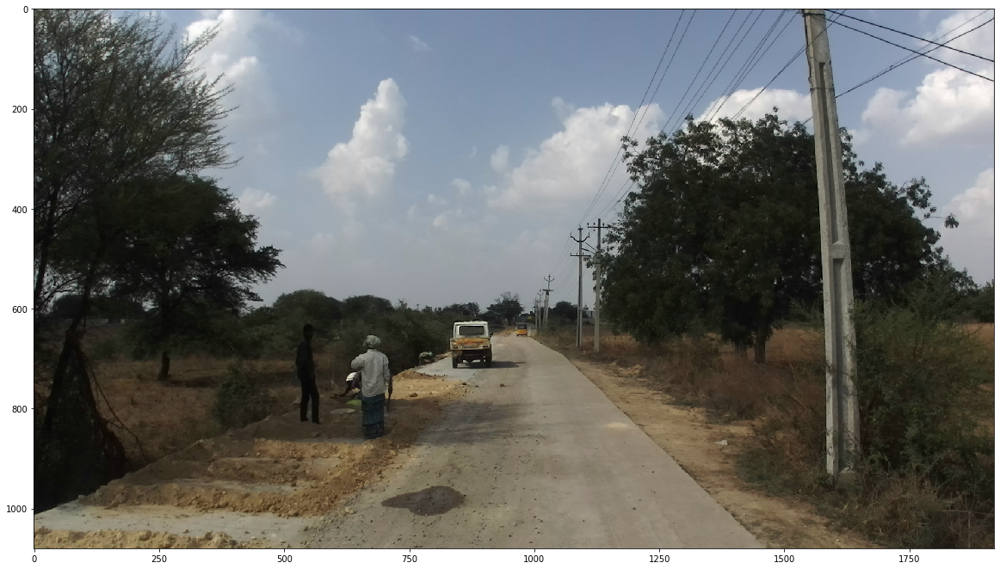

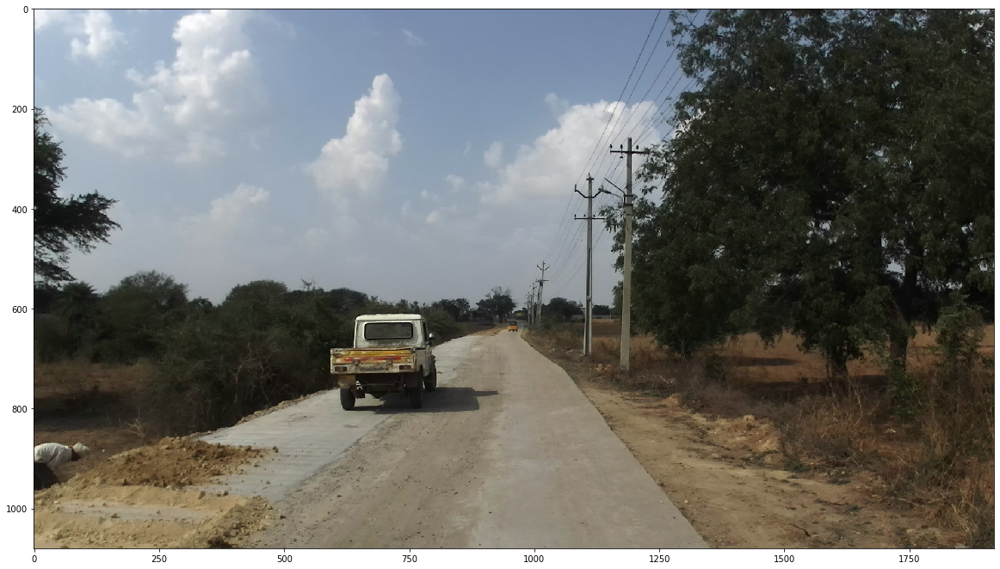

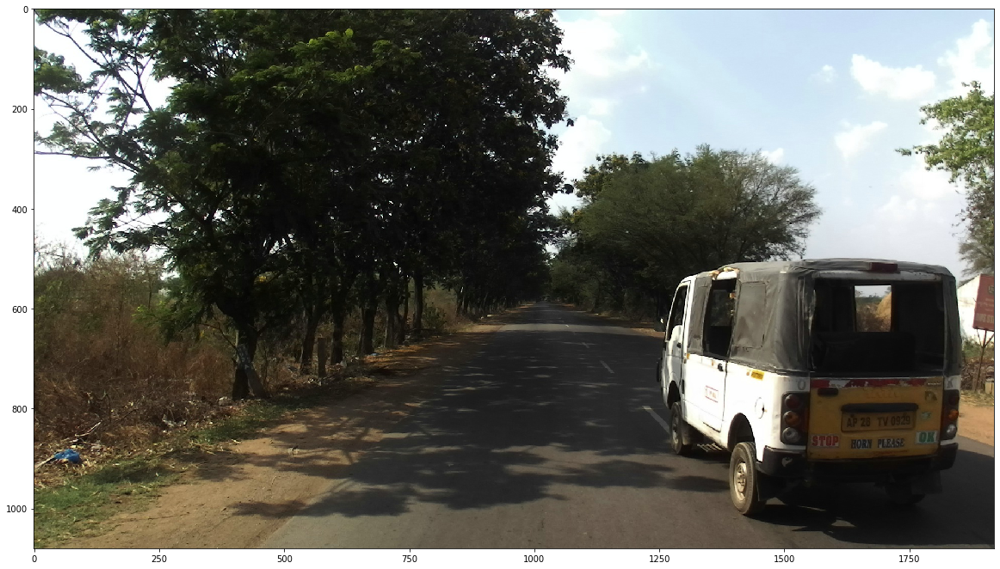

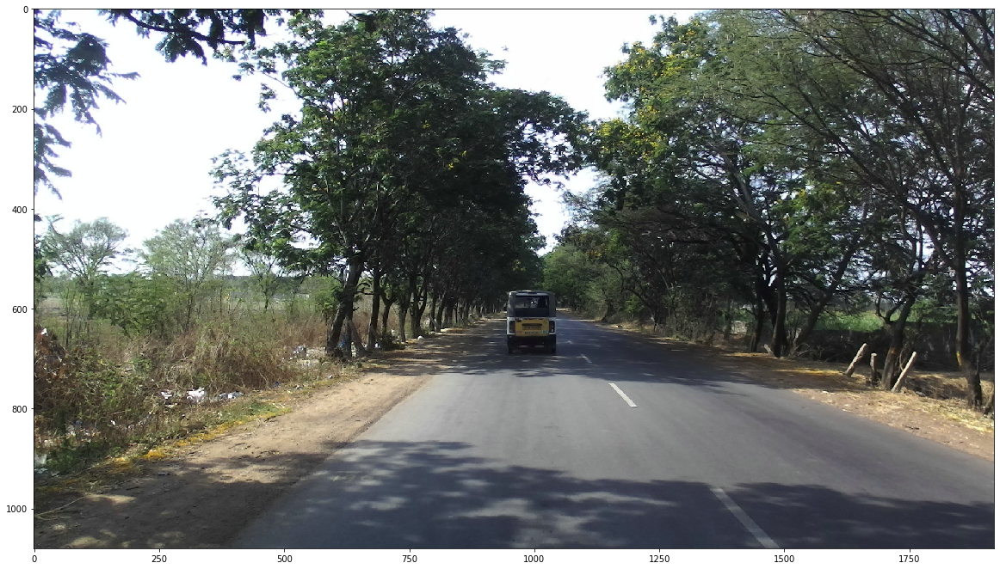

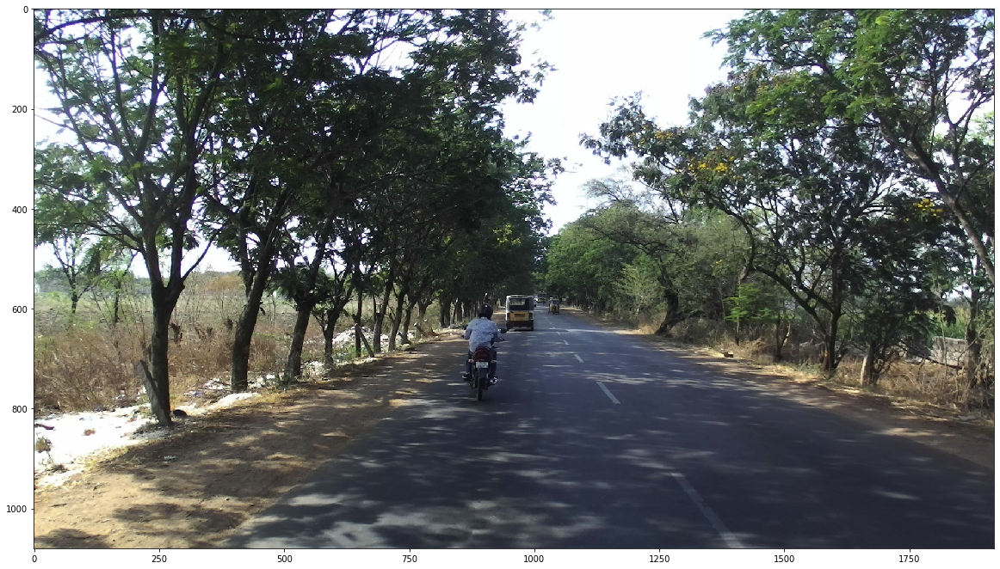

In [6]:
_bboxes, _labels, _scores = trainer.faster_rcnn.predict(imgs,visualize=True)
for i in range(len(img_paths)):
    vis_bbox(at.tonumpy(imgs[i]),
             at.tonumpy(_bboxes[i]),
             at.tonumpy(_labels[i]).reshape(-1),
             at.tonumpy(_scores[i]).reshape(-1))


# Do some predictions of "weird car" images from Google

./weird_cars/10.jpeg
./weird_cars/3.jpeg
./weird_cars/11.jpeg
./weird_cars/1.jpeg
./weird_cars/9.jpeg
./weird_cars/6.jpeg
./weird_cars/8.jpeg
./weird_cars/12.jpeg
./weird_cars/5.jpeg
./weird_cars/4.jpeg
./weird_cars/2.jpeg
./weird_cars/7.jpeg


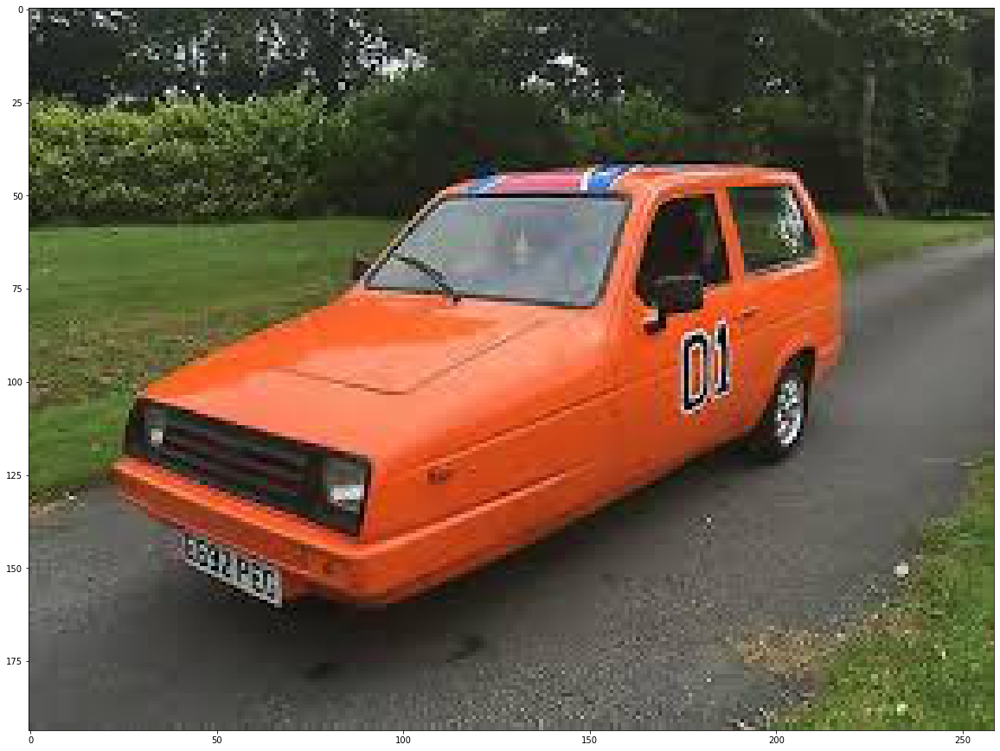

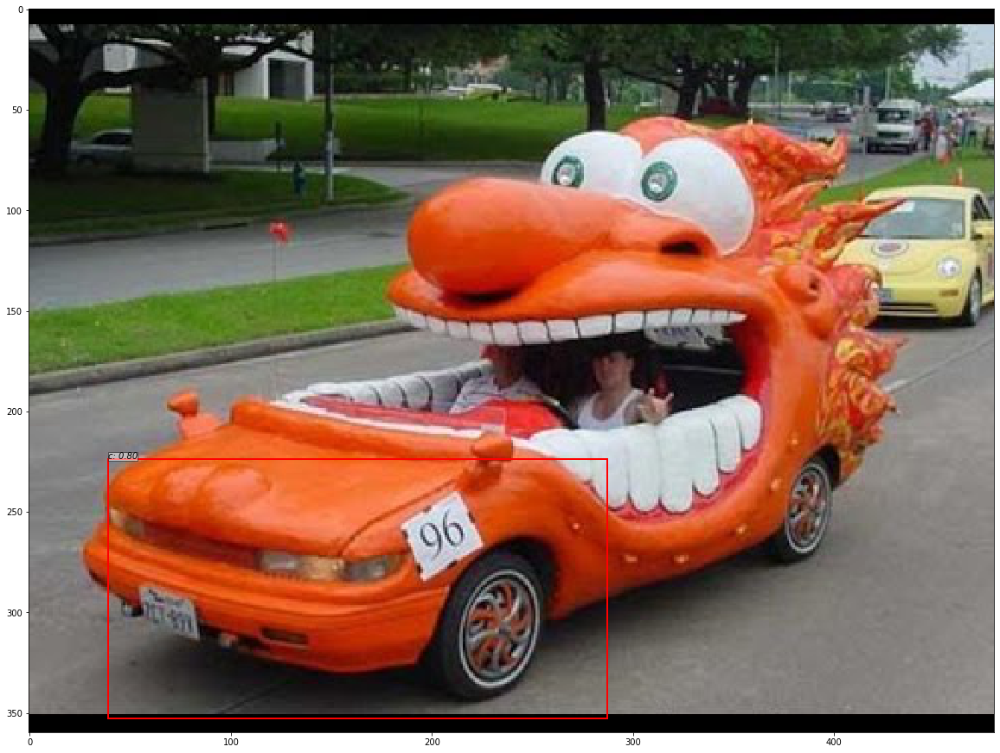

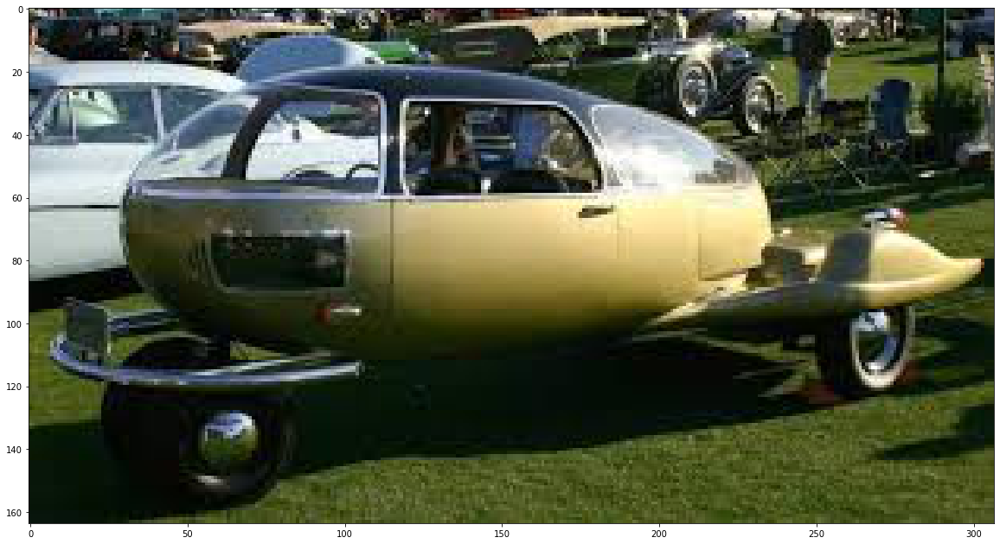

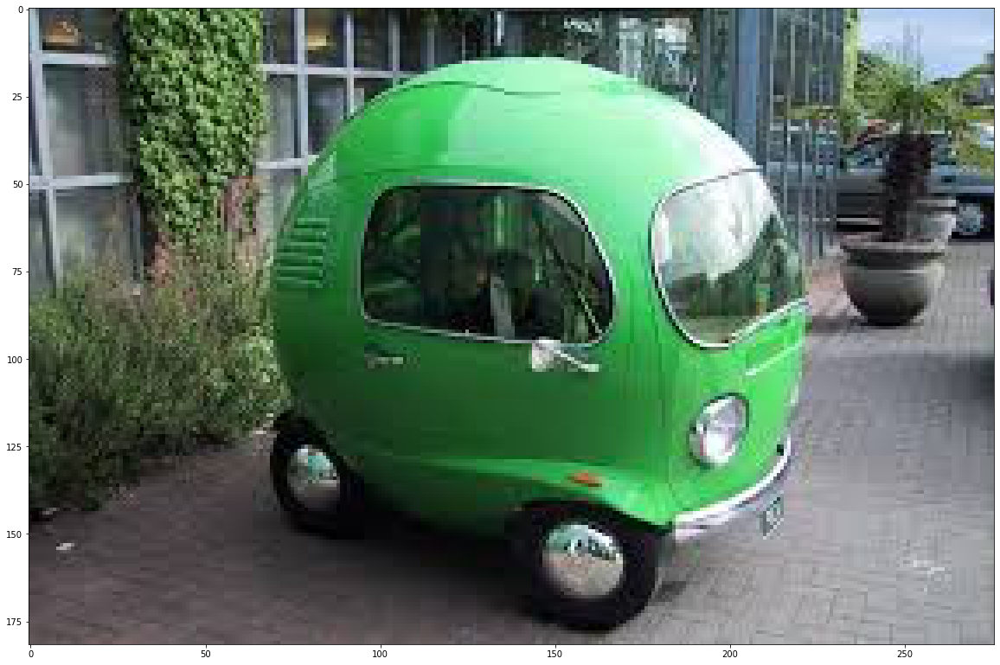

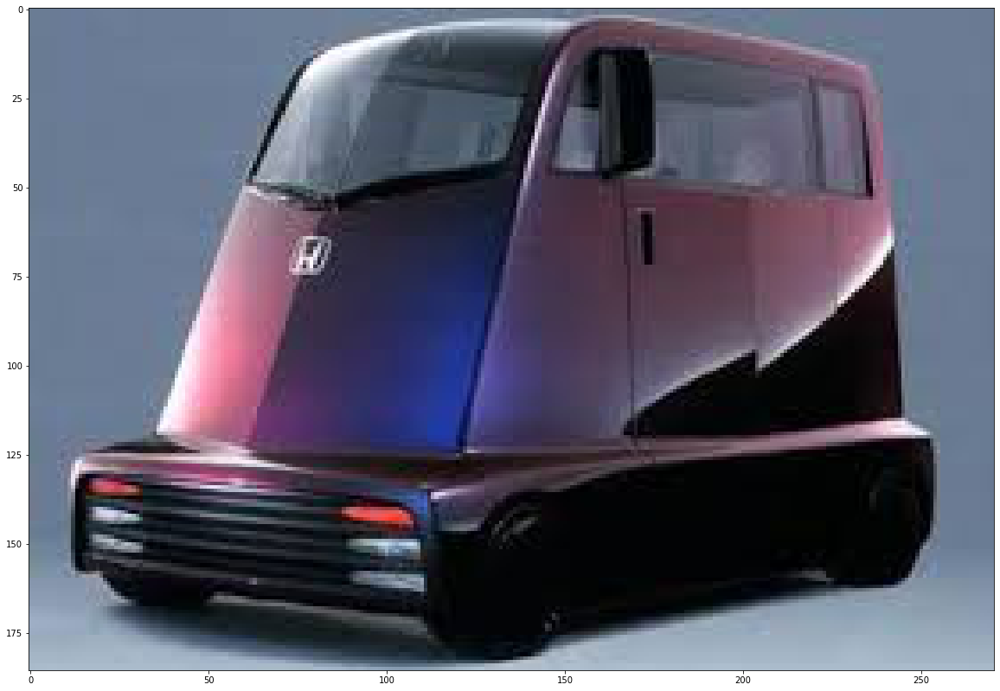

...

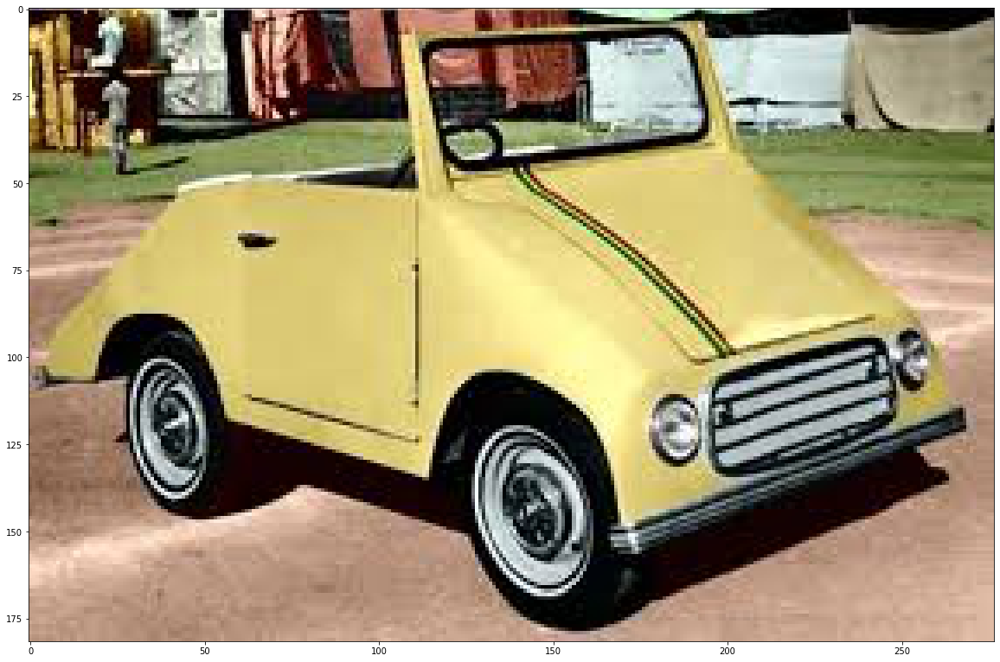

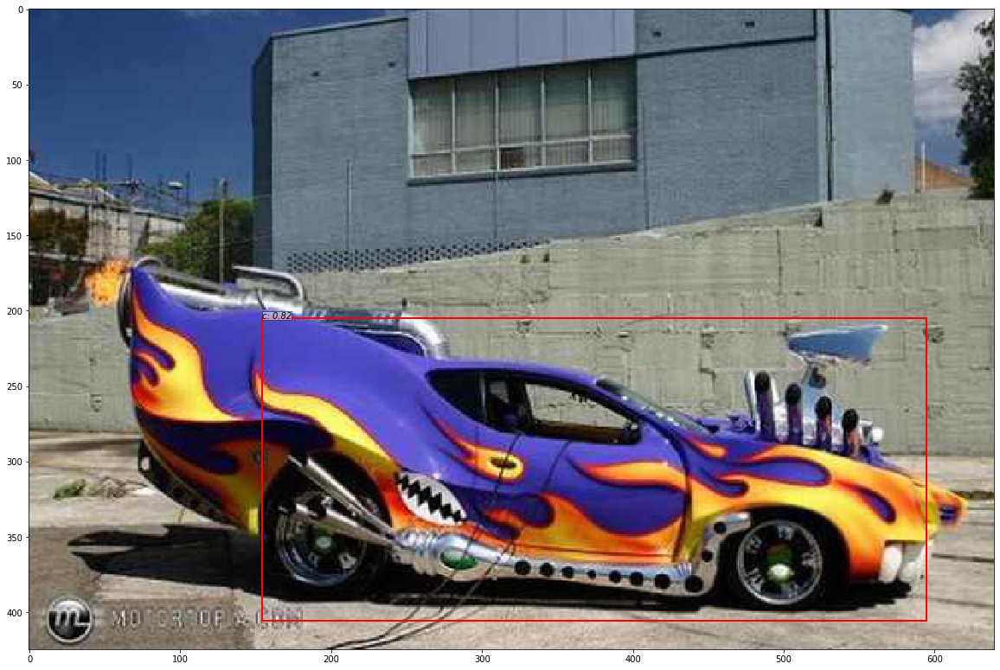

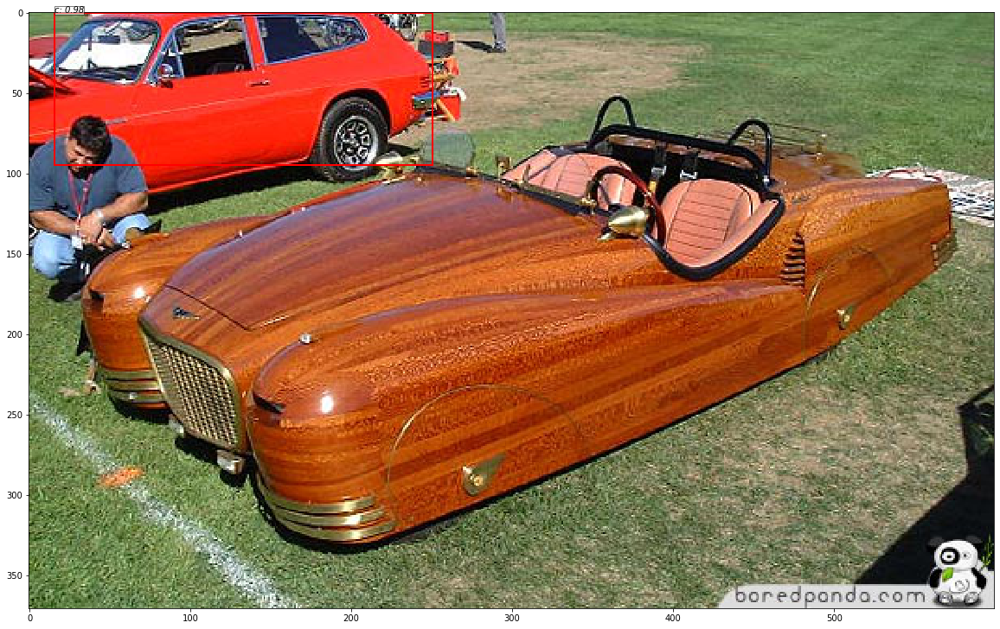

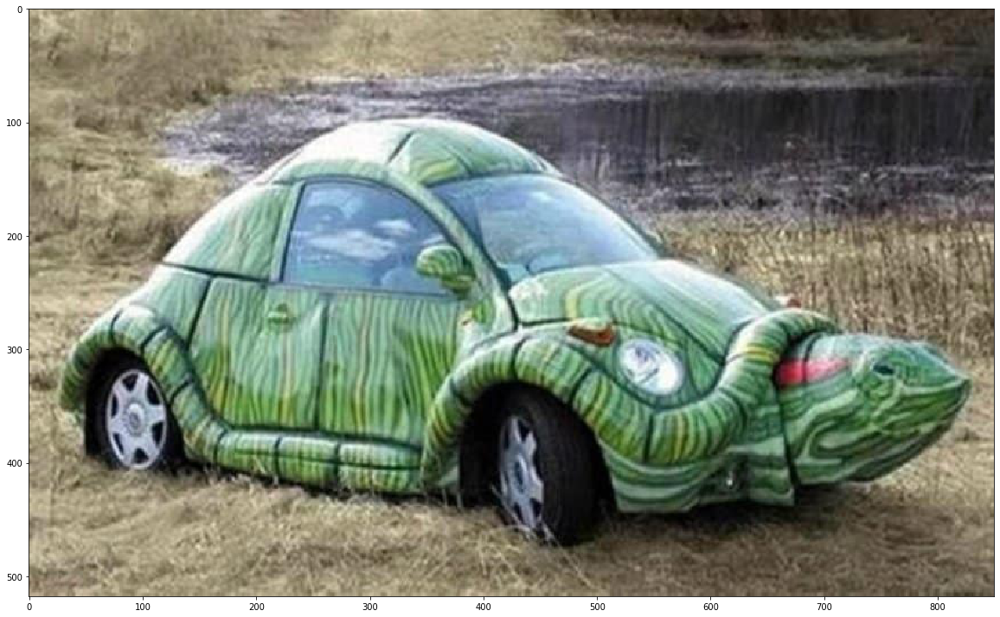

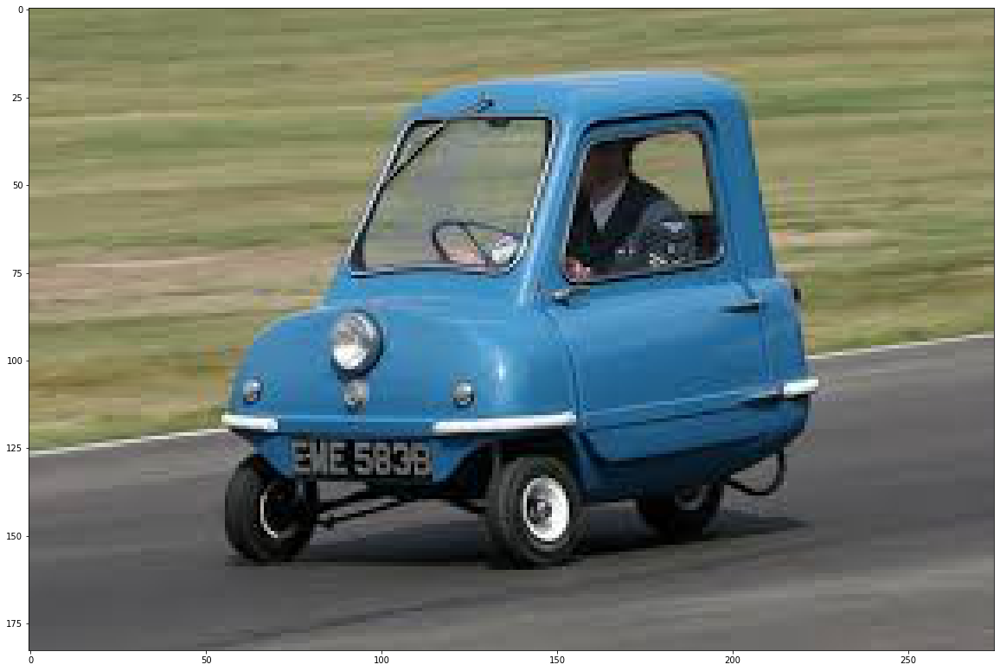

In [7]:
for img_name in os.listdir("./weird_cars"):
    img_path = os.path.join("./weird_cars", img_name)
    print(img_path)
    im = np.array(read_image(img_path))
    
    _bboxes, _labels, _scores = trainer.faster_rcnn.predict([im], visualize=True)
    
    vis_bbox(at.tonumpy(im),
         at.tonumpy(_bboxes[0]),
         at.tonumpy(_labels[0]).reshape(-1),
         at.tonumpy(_scores[0]).reshape(-1))

# Show uncertainty in objectness detector

In [8]:
dataset_dir = '/media/tadenoud/DATADisk/datasets/idd_detection/IDD_Detection/JPEGImages/'

# img = np.array([read_image(os.path.join(dataset_dir, 'rearNear/BLR-2018-05-07_12-01-06_rearNear/000600_r.jpg'))])
# img = np.array([read_image(os.path.join(dataset_dir, 'frontNear/BLR-2018-04-16_15-34-27_frontNear/0000120.jpg'))])
img = np.array([read_image(os.path.join(dataset_dir, 'frontNear/BLR-2018-04-26_13-00-01_frontNear/0000780.jpg'))])
# img = np.array([read_image('misc/demo.jpg')])
# img = np.array([read_image('./weird_cars/4.jpeg')])
SCALE = 1.

res = trainer.faster_rcnn.get_rpn_output(at.totensor(img), scales=[SCALE])

rpn_locs, rpn_scores, rois, roi_indices, anchor = res
rpn_locs = at.tonumpy(rpn_locs)
rpn_scores = at.tonumpy(rpn_scores)

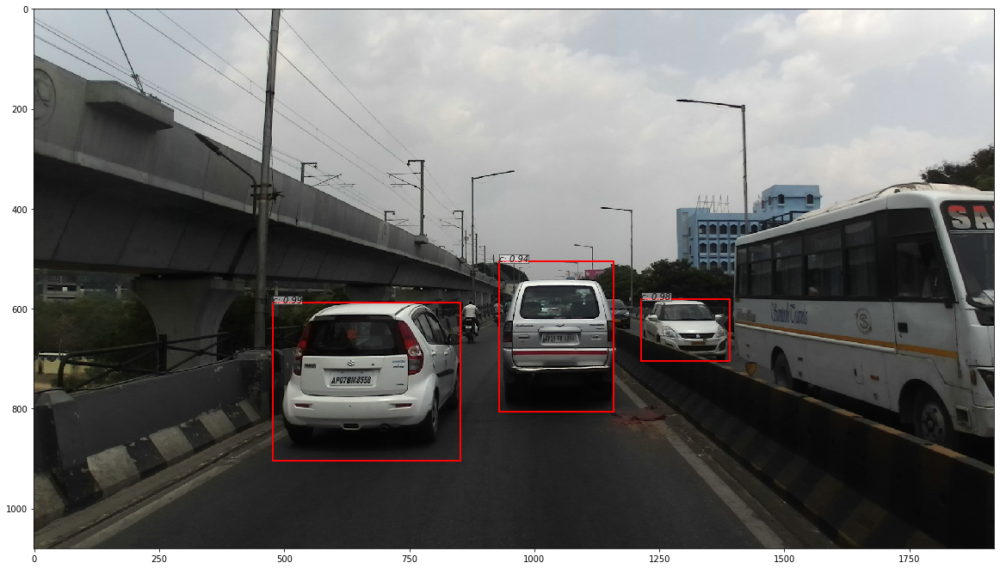

In [9]:
_bboxes, _labels, _scores = trainer.faster_rcnn.predict(img,visualize=True)

vis_bbox(at.tonumpy(img[0]),
         at.tonumpy(_bboxes[0]),
         at.tonumpy(_labels[0]).reshape(-1),
         at.tonumpy(_scores[0]).reshape(-1))

In [10]:
import torch.nn.functional as F
def softmax(x, dim=1):
    return at.tonumpy(F.softmax(at.totensor(x), dim=dim))

rpn_scores = softmax(rpn_scores, dim=2)
rpn_scores

array([[[0.86009806, 0.1399019 ],
        [0.99409664, 0.00590333],
        [0.48697832, 0.5130217 ],
        ...,
        [0.6782508 , 0.32174918],
        [0.52349037, 0.47650963],
        [0.48330972, 0.5166903 ]]], dtype=float32)

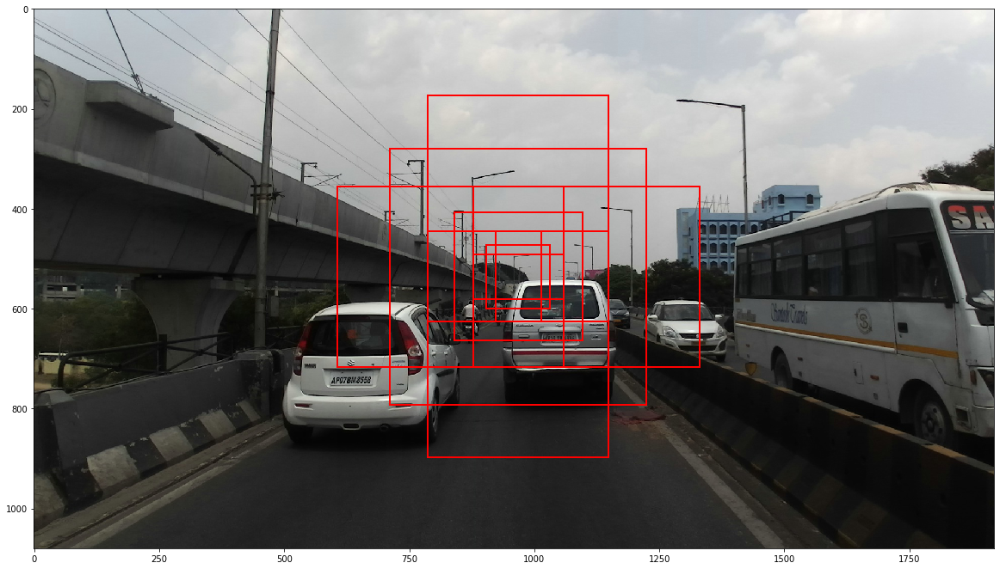

In [15]:
halfway = int(len(anchor) / 2)
halfway -= halfway % 9
vis_bbox(at.tonumpy(img[0]), at.tonumpy(anchor)[halfway:halfway+9])

## Visualize uncertain boxes

In [590]:
import mc_uncertainty as mcu
ent = mcu.entropy(rpn_scores)[0]
ent_sorted = np.argsort(ent)

### Most uncertain

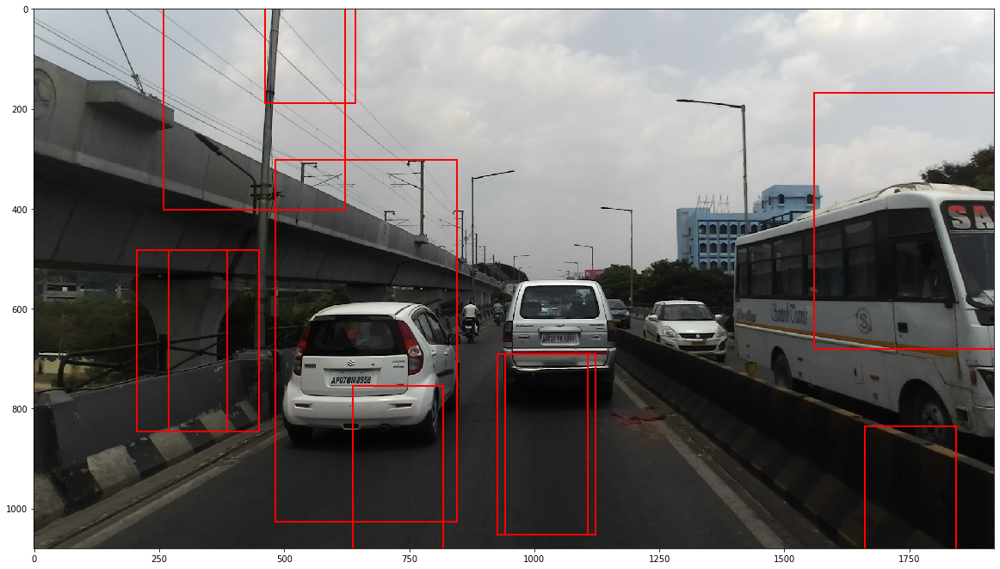

In [591]:
max_10_top_ent = ent_sorted[-10:]
vis_bbox(at.tonumpy(img[0]), at.tonumpy(anchor)[max_10_top_ent])

### Most certain

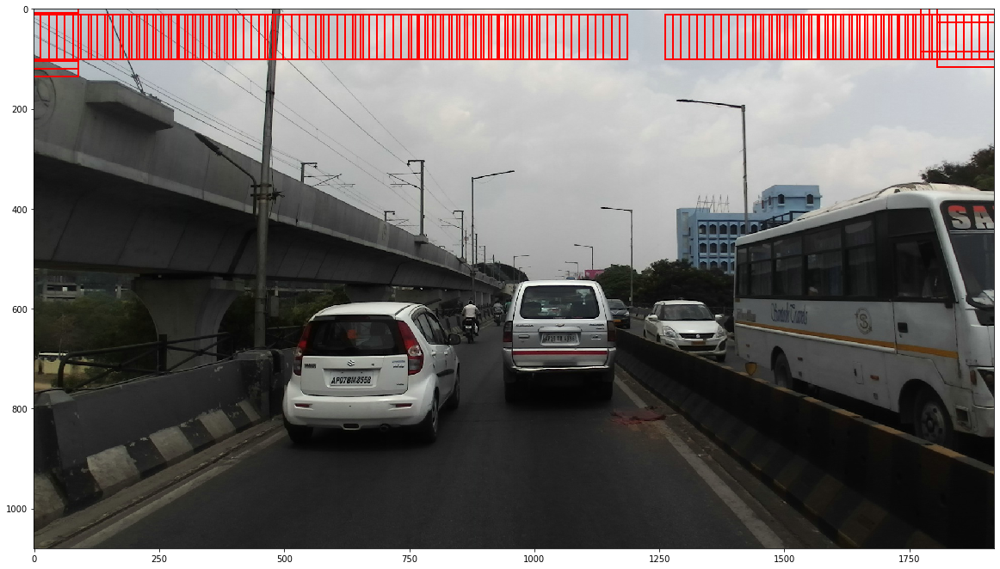

In [592]:
min_50_top_ent = ent_sorted[:100]
vis_bbox(at.tonumpy(img[0]), at.tonumpy(anchor)[min_50_top_ent])

### All proposed ROIs

In [593]:
obj_scores = rpn_scores[0,:,1]
obj_sorted = np.argsort(obj_scores)

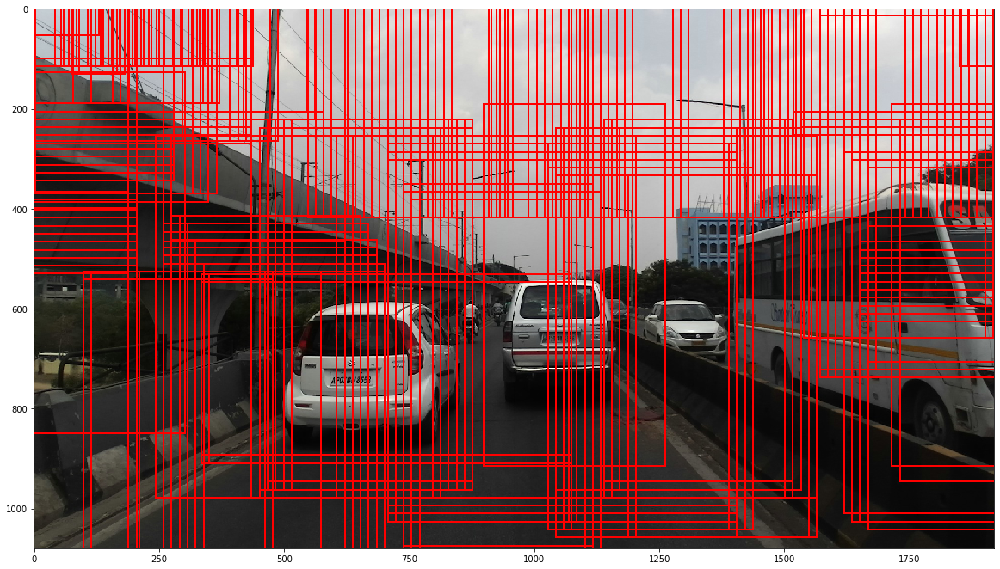

In [594]:
max_300_obj = obj_sorted[-300:]
vis_bbox(at.tonumpy(img[0]), at.tonumpy(anchor)[max_300_obj])

### Most object-like

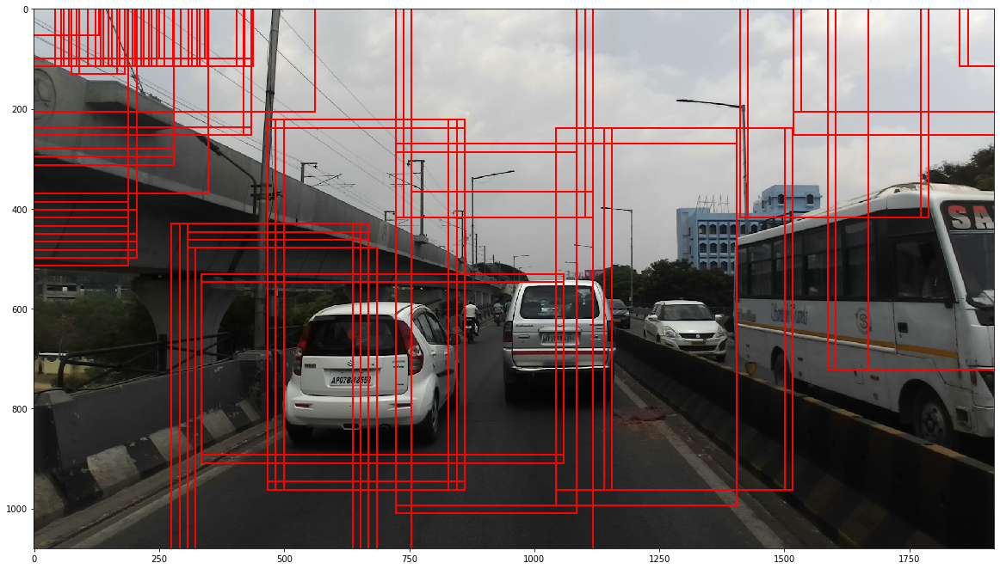

In [579]:
max_100_obj = obj_sorted[-100:]
vis_bbox(at.tonumpy(img[0]), at.tonumpy(anchor)[max_100_obj])

### Most background-like

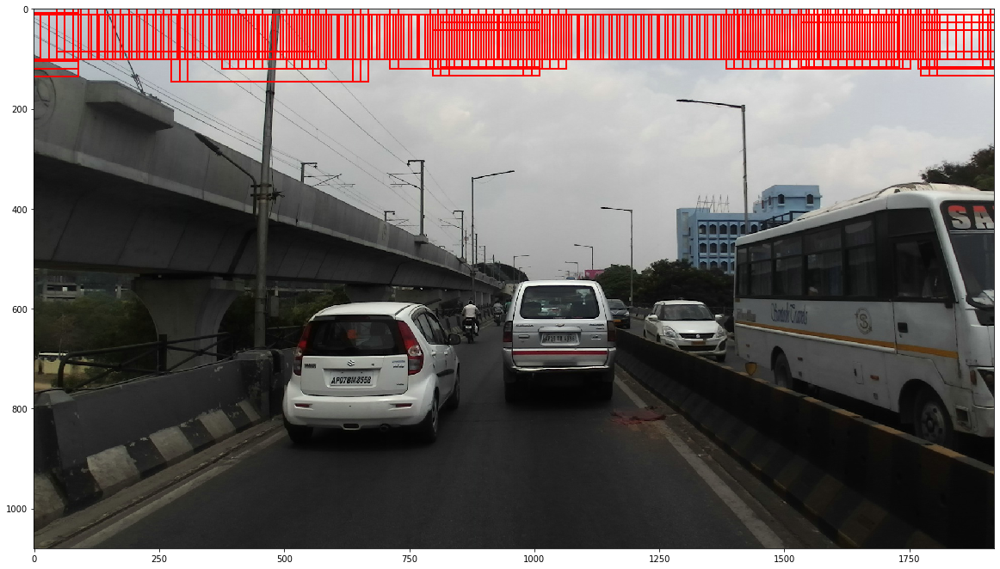

In [580]:
min_100_obj = obj_sorted[:200]
vis_bbox(at.tonumpy(img[0]), at.tonumpy(anchor)[min_100_obj])

### Uncertainty heatmap

In [581]:
_, _, max_y, max_x = img.shape

u_count = np.zeros(img.shape[2:])
u_sum = np.zeros(img.shape[2:])

for anc, entropy in zip(list(anchor), list(ent)):
    y1, x1, y2, x2 = anc
    x1 = np.clip(x1, 0, max_x).astype(np.int)
    x2 = np.clip(x2, 0, max_x).astype(np.int)
    y1 = np.clip(y1, 0, max_y).astype(np.int)
    y2 = np.clip(y2, 0, max_y).astype(np.int)

    u_count[y1:y2,x1:x2] += 1
    u_sum[y1:y2,x1:x2] += entropy
    
u = np.divide(u_sum, u_count.astype(np.float))

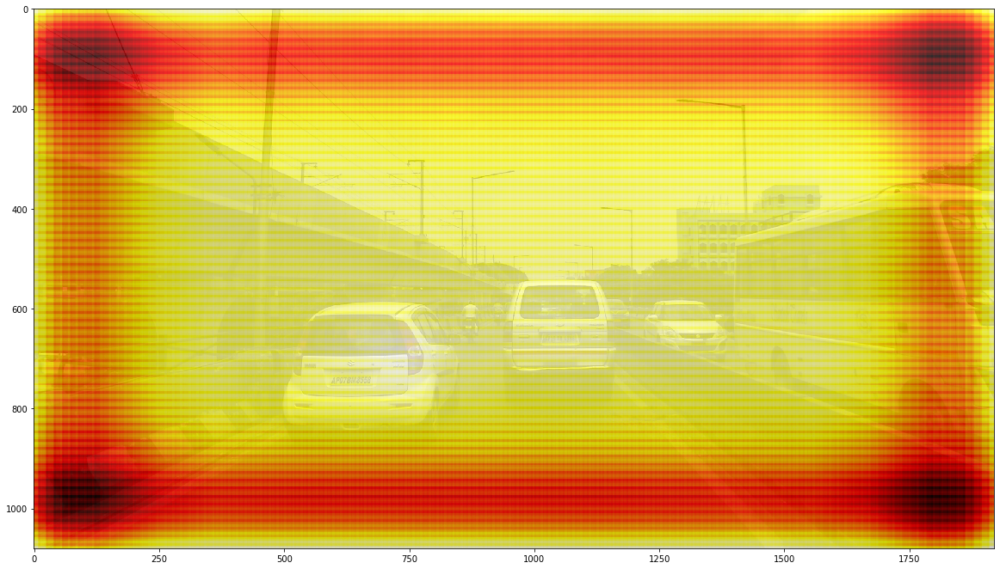

In [582]:
plt.figure(figsize=(20,20))
plt.imshow(img[0].transpose((1, 2, 0)).astype(np.uint8))
plt.imshow(u, cmap='hot', alpha=.8)
plt.show()

In [583]:
_, _, max_y, max_x = img.shape

u_count = np.zeros(img.shape[2:])
u_sum = np.zeros(img.shape[2:])

for anc, entropy in zip(list(anchor), list(ent)):
    y1, x1, y2, x2 = anc
    x1 = x1.astype(np.int)
    x2 = x2.astype(np.int)
    y1 = y1.astype(np.int)
    y2 = y2.astype(np.int)
    
    if (x1 >=0 and x1 <= max_x) and (x2 >=0 and x2 <= max_x) and \
        (y1 >=0 and y1 <= max_y) and (y2 >=0 and y2 <= max_y):

        u_count[y1:y2,x1:x2] += 1
        u_sum[y1:y2,x1:x2] += entropy
        
u = np.divide(u_sum, u_count.astype(np.float))

/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in true_divide
/home/tadenoud/anaconda3/envs/nn/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in true_divide


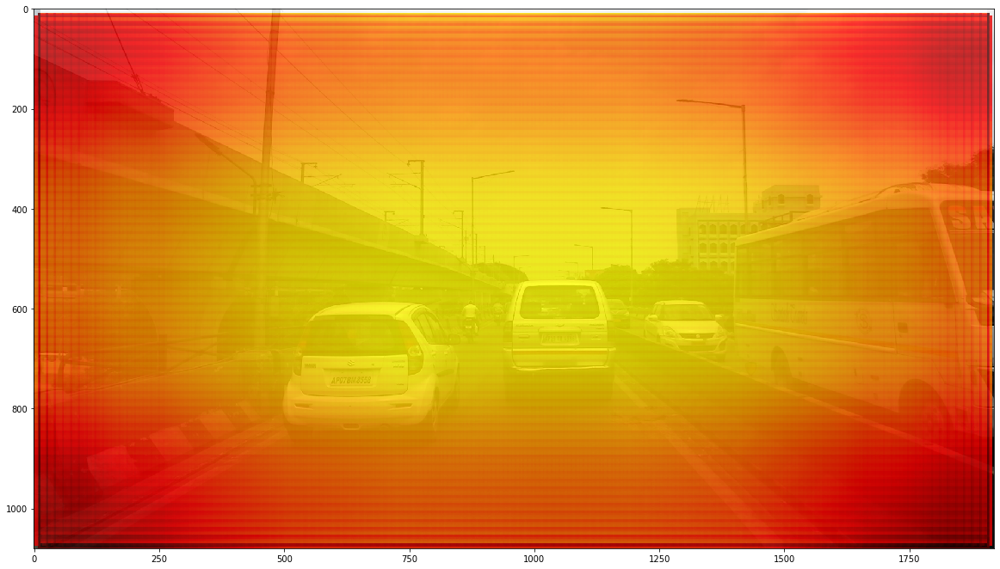

In [584]:
plt.figure(figsize=(20,20))
plt.imshow(img[0].transpose((1, 2, 0)).astype(np.uint8))
plt.imshow(u, cmap='hot', alpha=.8)
plt.show()

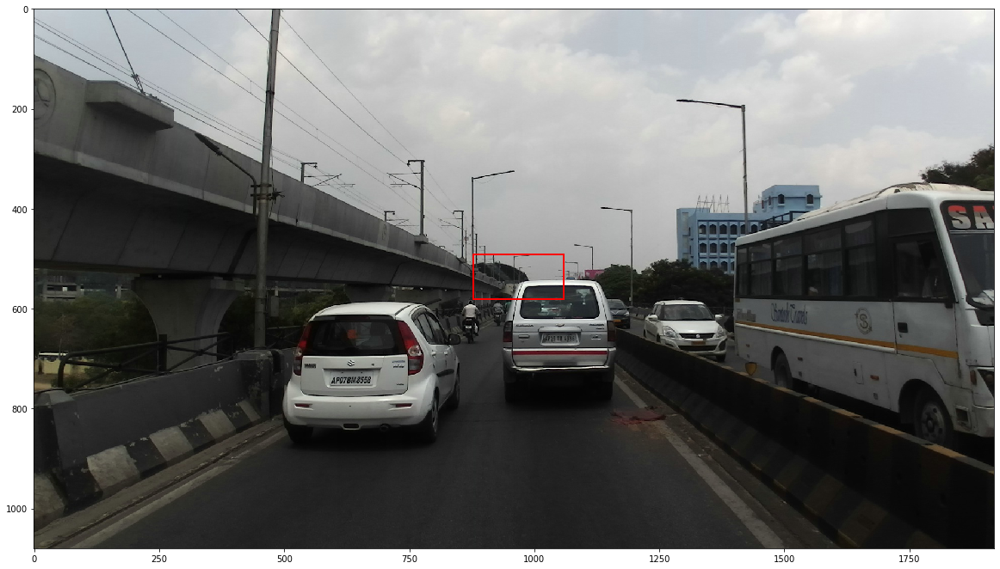

<Figure size 1440x1440 with 0 Axes>

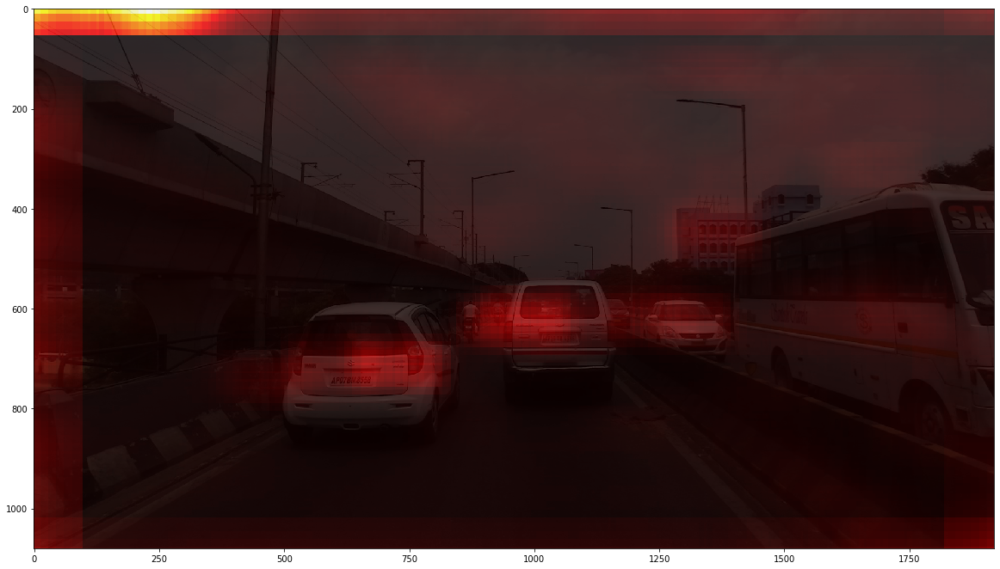

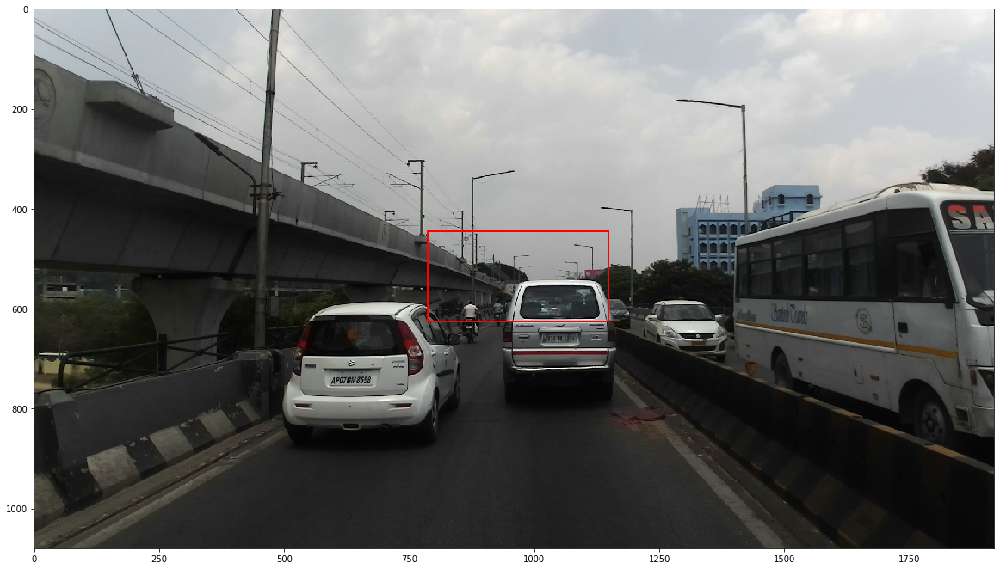

<Figure size 1440x1440 with 0 Axes>

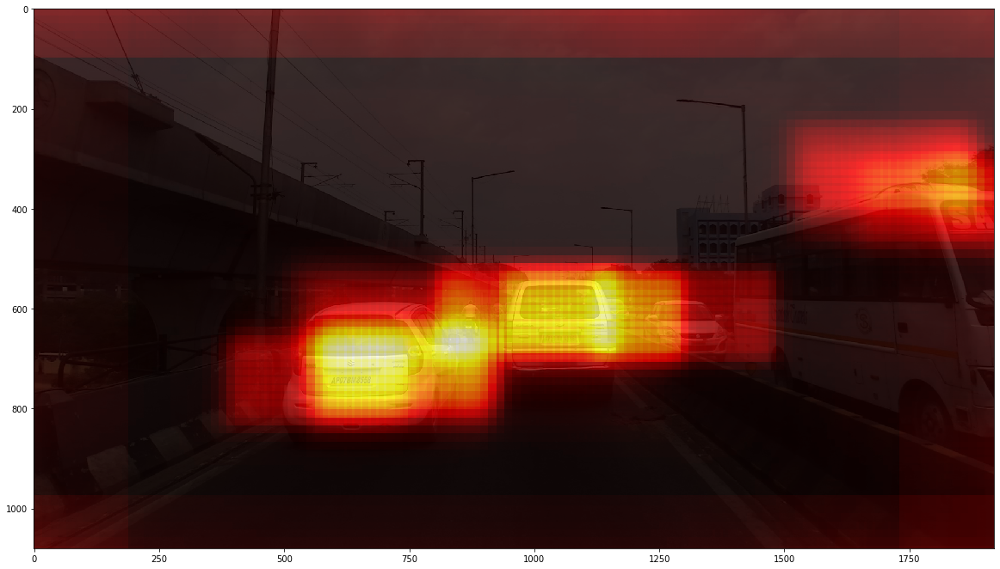

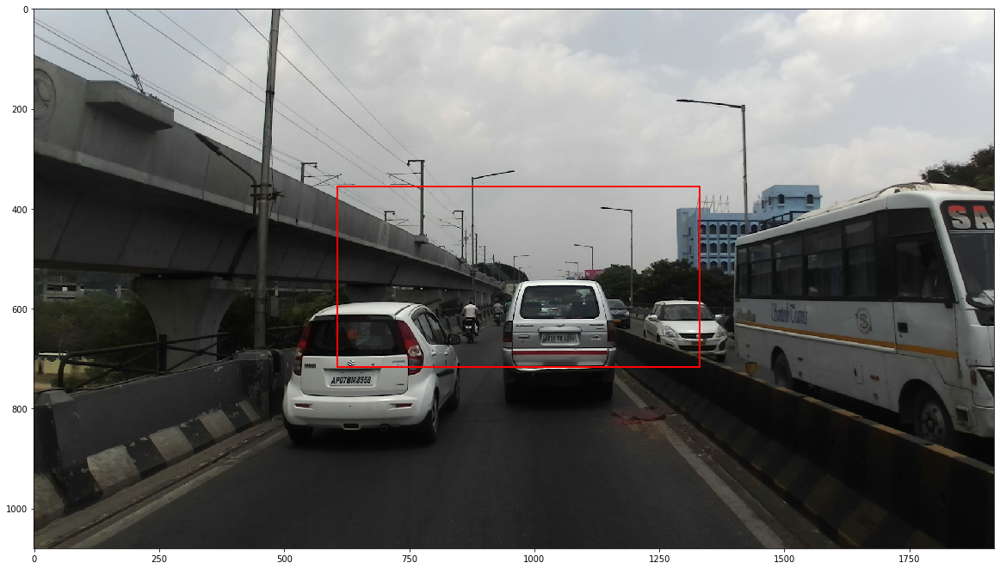

<Figure size 1440x1440 with 0 Axes>

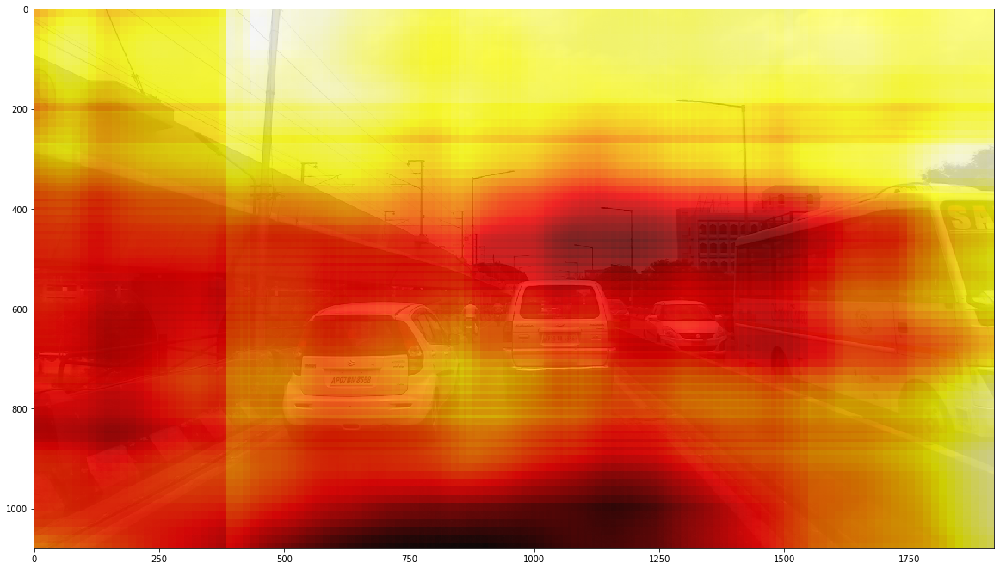

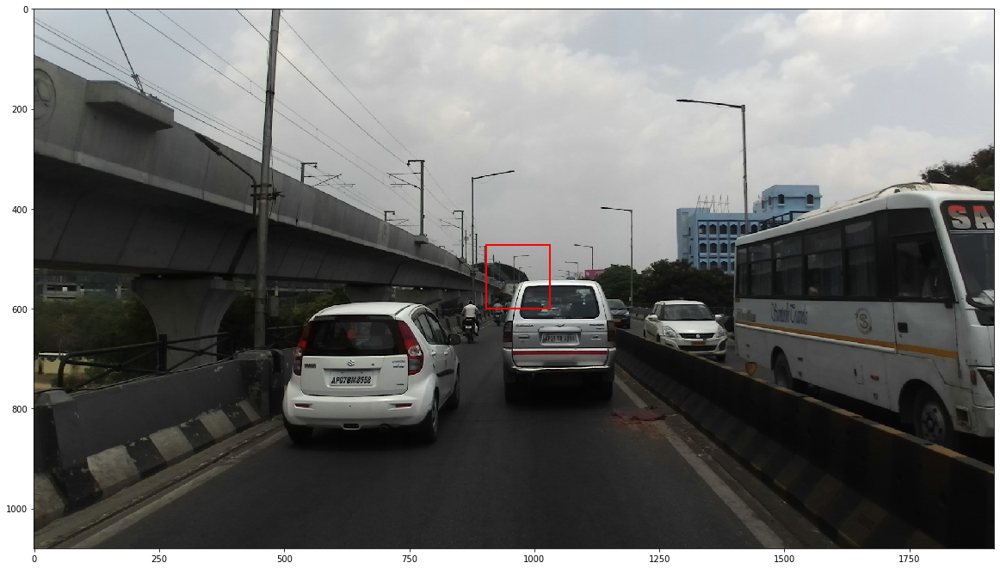

<Figure size 1440x1440 with 0 Axes>

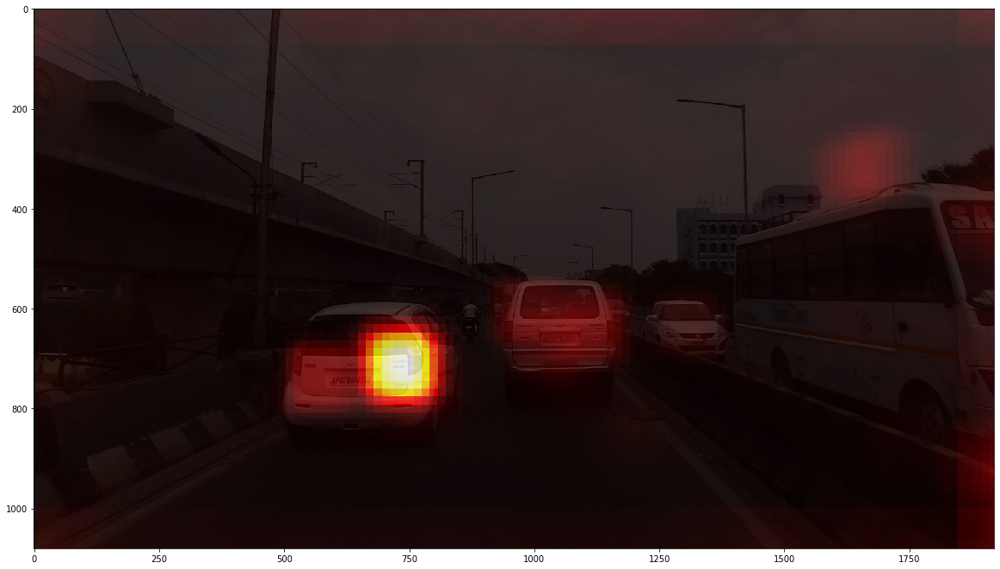

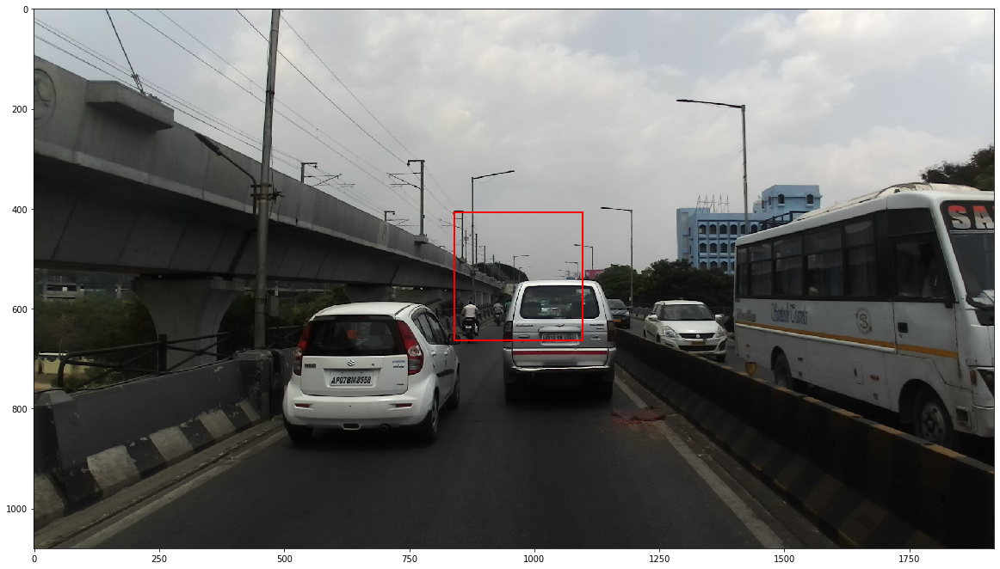

<Figure size 1440x1440 with 0 Axes>

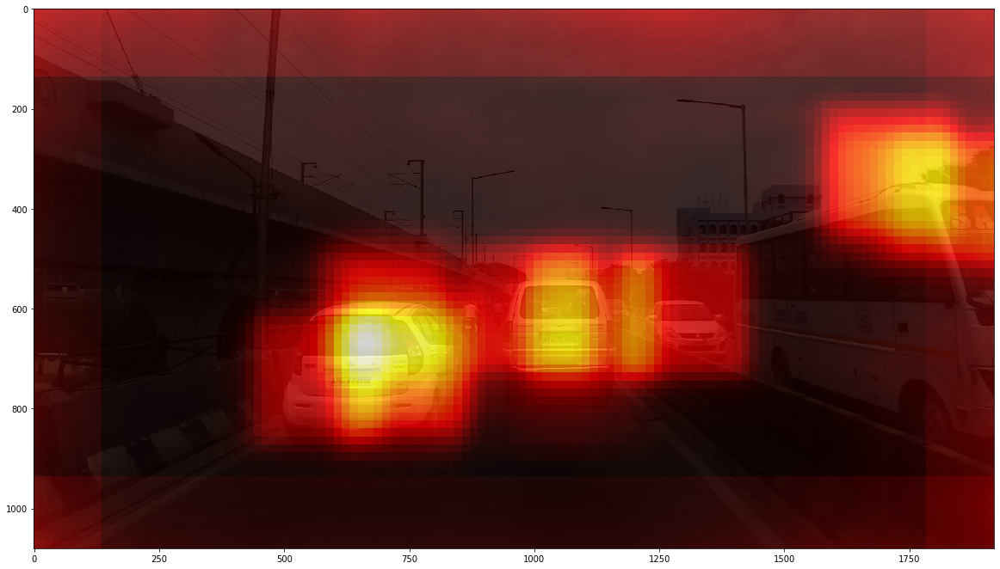

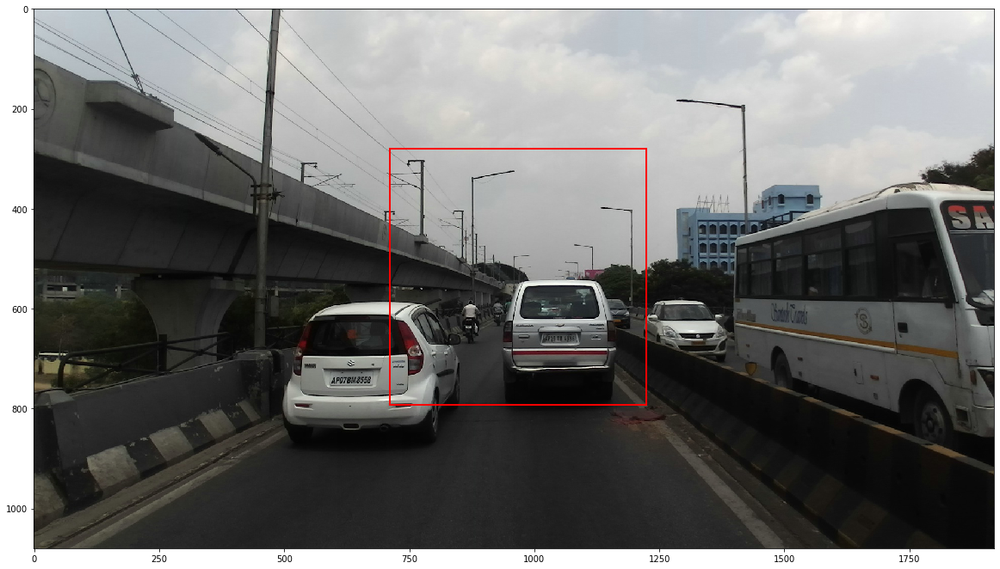

<Figure size 1440x1440 with 0 Axes>

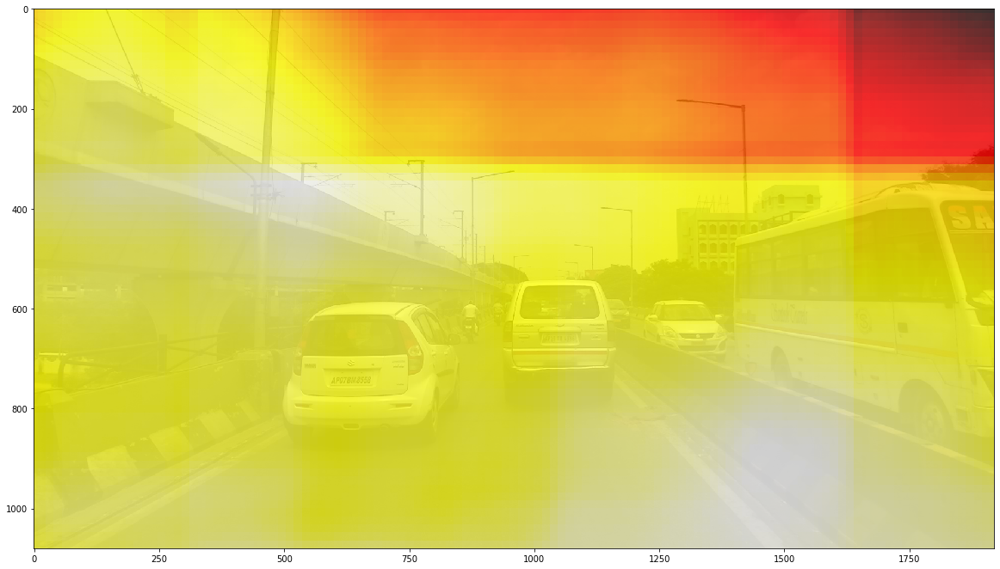

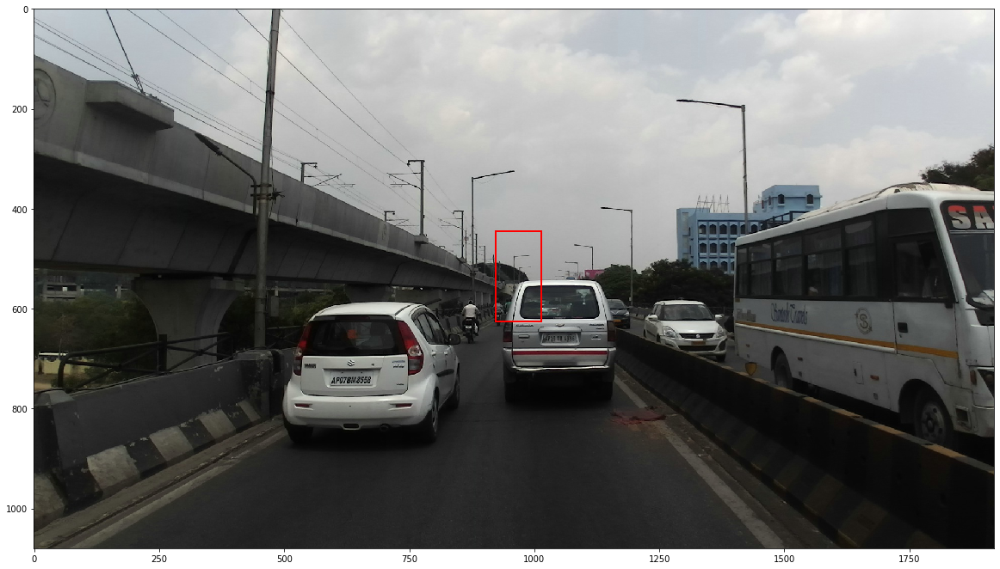

<Figure size 1440x1440 with 0 Axes>

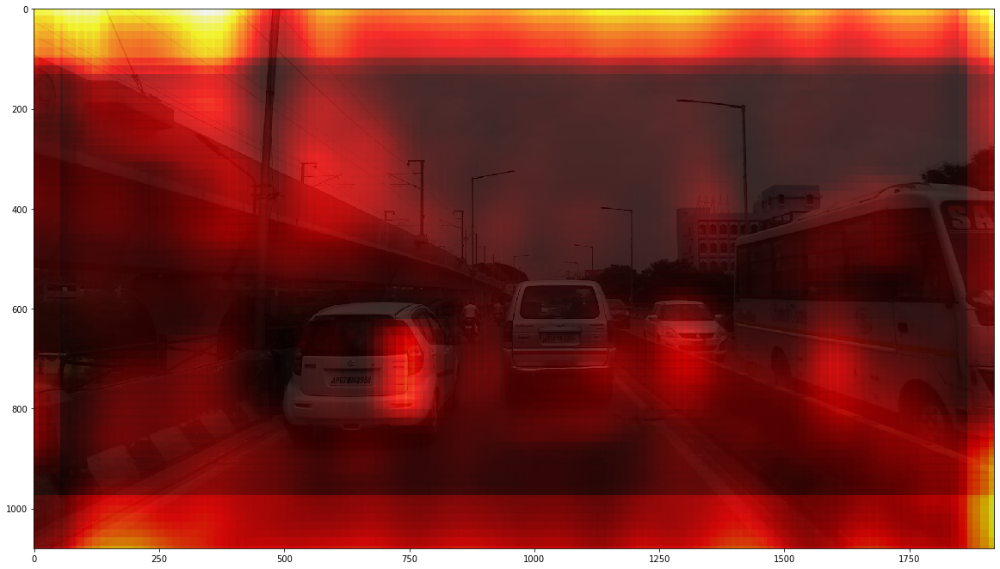

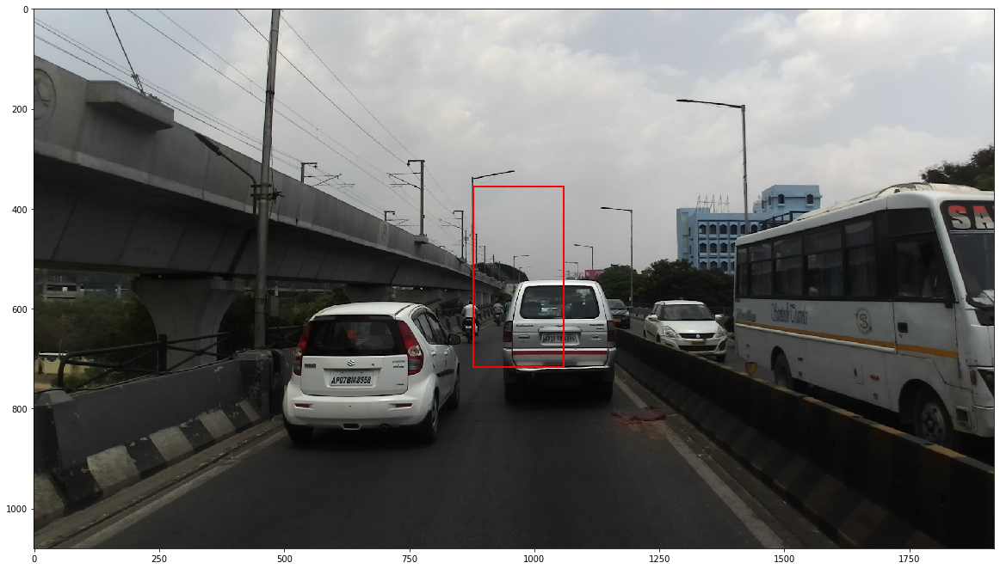

<Figure size 1440x1440 with 0 Axes>

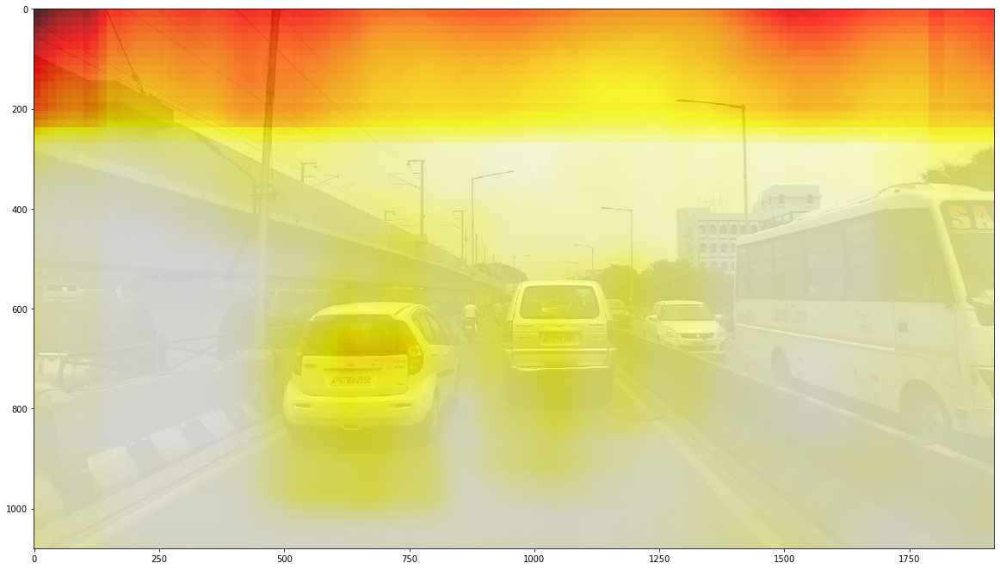

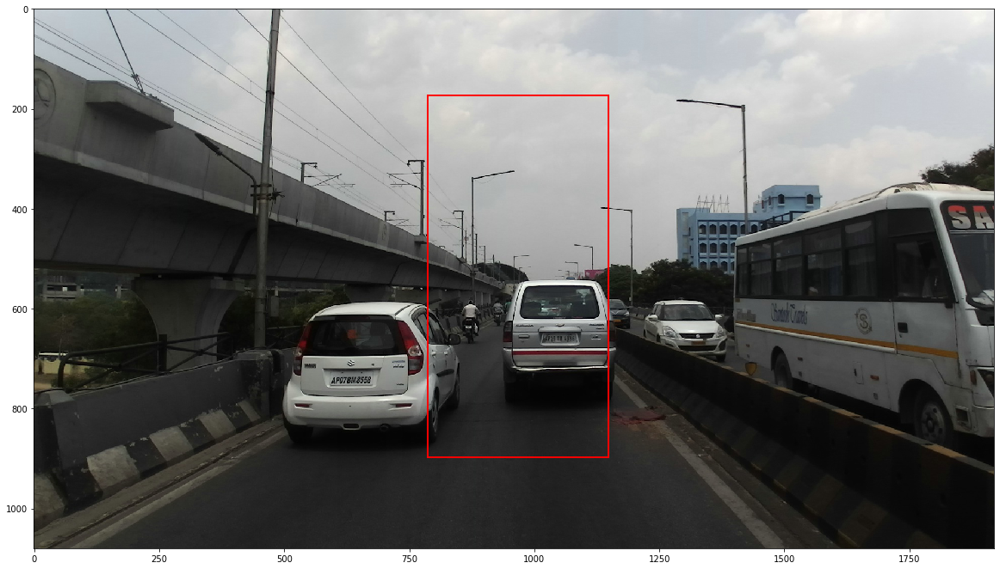

<Figure size 1440x1440 with 0 Axes>

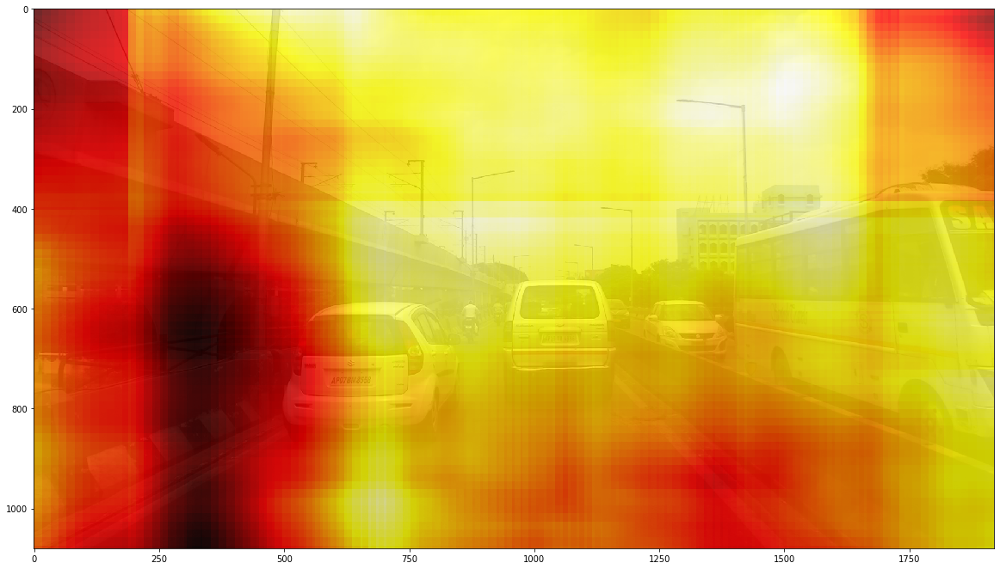

In [585]:
for box_n in range(9):
    u_count = np.zeros(img.shape[2:])
    u_sum = np.zeros(img.shape[2:])
    
    for anc, entropy in zip(list(anchor)[box_n::9], list(ent)[box_n::9]):
        y1, x1, y2, x2 = anc
        x1 = np.clip(x1, 0, max_x).astype(np.int)
        x2 = np.clip(x2, 0, max_x).astype(np.int)
        y1 = np.clip(y1, 0, max_y).astype(np.int)
        y2 = np.clip(y2, 0, max_y).astype(np.int)


        u_count[y1:y2,x1:x2] += 1
        u_sum[y1:y2,x1:x2] += entropy
    
    vis_bbox(at.tonumpy(img[0]), at.tonumpy(anchor)[halfway + box_n:halfway + box_n + 1])
    
    u = np.divide(u_sum, u_count.astype(np.float))
    plt.figure(figsize=(20,20))

    plt.figure(figsize=(20,20))
    plt.imshow(img[0].transpose((1, 2, 0)).astype(np.uint8))
    plt.imshow(u, cmap='hot', alpha=.8)
    
    plt.show()